In [1]:
# Importing libraries

import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import cv2

from imgaug import augmenters as iaa
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
import imageio

In [2]:
data_dir = 'data' # data directory

# printing all the folders/files within the data directory
print(os.listdir(data_dir))

['train_df.csv', 'Train data', 'Test data']


In [3]:
def get_file_path_df(folder):
  """
  Function to get path of .jpg files in the specified folder
  takes folder input and returns pandas dataframe
  """
  image_path = [] 
  for root, dirs, files in os.walk(folder):
    for f in files:
      if f.endswith(".JPG"): # checking for JPG extension 
        image_path.append(os.path.join(root, f)) # appending to image_path list
  # df = dataframe
  df_cols = {'path': image_path} # creating a dictionary
  df = pd.DataFrame(df_cols) # creating a dataframe
  return df

In [4]:
# getting absolute path of all images and storing in a dataframe called data_df
data_df = get_file_path_df(data_dir)

# displying random 5 rows
data_df.sample(5)

,path
3911,data/Test data/G0029000.JPG
1731,data/Train data/Negative data/G0027175.JPG
1890,data/Train data/Negative data/G0066157.JPG
2163,data/Train data/Negative data/G0027812.JPG
1044,data/Train data/Positive data/G0027034.JPG


In [5]:
data_df.shape

(4405, 1)

### Data preprocessing

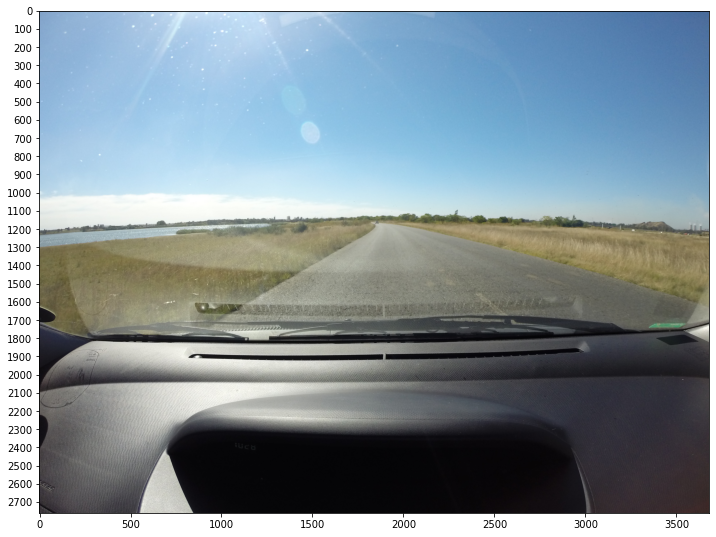

In [6]:
# plot an image randomly

row = np.random.randint(data_df.shape[0], size=1)[0]
sample_img = data_df.iloc[row, :]

plt.figure(figsize = (12, 50))
path = sample_img['path'] # image path
img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.yticks(np.arange(0, img.shape[0], 100))
plt.show()

### Observations:
* From the above plot we can see that our area of interest lies in the range of 0 to 1800 pixel along y axis
* Image part greater than 1800 pixel contains car dashboard, there is chance of model recognizing it as a pothole
* Also it simply increases the computation time so lets remove it

In [6]:
# annotation data (bounding boxes)

annotation_df = pd.read_csv(os.path.join(data_dir, 'train_df.csv'))
annotation_df.head()

,image_id,num_potholes,x,y,w,h
0,G0010033,6,1990,1406,66,14
1,G0010033,6,1464,1442,92,16
2,G0010033,6,1108,1450,54,16
3,G0010033,6,558,1434,102,16
4,G0010033,6,338,1450,72,18


In [7]:
annotation_df.shape

(4592, 6)

In [8]:
# remove duplicates if exists
annotation_df.drop_duplicates(keep='first', inplace=True)
annotation_df.reset_index(inplace=True, drop=True)
annotation_df.head()

,image_id,num_potholes,x,y,w,h
0,G0010033,6,1990,1406,66,14
1,G0010033,6,1464,1442,92,16
2,G0010033,6,1108,1450,54,16
3,G0010033,6,558,1434,102,16
4,G0010033,6,338,1450,72,18


In [9]:
annotation_df.shape

(3676, 6)

In [10]:
# add x_max and y_max columns (right extreme point)

annotation_df['x_max'] = annotation_df['x'] + annotation_df['w']
annotation_df['y_max'] = annotation_df['y'] + annotation_df['h']
print("Data frame after updating columns")
print()
annotation_df.head()

Data frame after updating columns



,image_id,num_potholes,x,y,w,h,x_max,y_max
0,G0010033,6,1990,1406,66,14,2056,1420
1,G0010033,6,1464,1442,92,16,1556,1458
2,G0010033,6,1108,1450,54,16,1162,1466
3,G0010033,6,558,1434,102,16,660,1450
4,G0010033,6,338,1450,72,18,410,1468


In [11]:
# annotation_df.to_csv('test.csv', index=False)

* From above plot we got to know that the area of interest lies within the range of 0 to 1800 pixel along y axis
* Lets check the pixel range for all other images including bonding boxes 

In [11]:
# maximum right exterme y cooridinate
y_max = annotation_df['y_max'].values.max()
print('Maximum value of y-coordinate of a BBox:', y_max)

Maximum value of y-coordinate of a BBox: 2018


In [13]:
# lets check the percentile values of y coordinate

# print 0 to 100 percentile values of BBox (y_coord + height) with step size of 10. 
for i in range(0,100,10):
    # var = annotation_df['y'].values + annotation_df['h'].values
    var = annotation_df['y_max'].values
    var = np.sort(var,axis = None)
    print("{} percentile value is {}".format(i,var[int(len(var)*(float(i)/100))]))
print ("100 percentile value is ",var[-1])

0 percentile value is 1212
10 percentile value is 1332
20 percentile value is 1382
30 percentile value is 1430
40 percentile value is 1480
50 percentile value is 1528
60 percentile value is 1576
70 percentile value is 1624
80 percentile value is 1672
90 percentile value is 1740
100 percentile value is  2018


90 percent of bounding boxes have y coordinate values less than or equal to 1740 pixel

In [14]:
## print 90 to 100 percentile values of BBox (y_coord + height) with step size of  1. 

for i in range(90,100,1):
    # var = annotation_df['y'].values + annotation_df['h'].values
    var = annotation_df['y_max'].values
    var = np.sort(var,axis = None)
    print("{} percentile value is {}".format(i,var[int(len(var)*(float(i)/100))]))
print ("100 percentile value is ",var[-1])

90 percentile value is 1740
91 percentile value is 1756
92 percentile value is 1766
93 percentile value is 1774
94 percentile value is 1790
95 percentile value is 1806
96 percentile value is 1838
97 percentile value is 1880
98 percentile value is 1920
99 percentile value is 1964
100 percentile value is  2018


* 99 percent of bounding boxes have y coordinate values less than or equal to 1964 pixel
* So consider 0-1964 as the area of interest and remove all the bonding boxes having y coordinate greater than 1964
* Also crop all the images and discard the image part greater than the 1964 pixel

In [12]:
y_max = 1964

In [13]:
# remove all the bounding boxes having y coordinate greater than 1976 pixel
annotation_df_new = annotation_df[annotation_df['y_max'] <= y_max]
annotation_df_new.head()

,image_id,num_potholes,x,y,w,h,x_max,y_max
0,G0010033,6,1990,1406,66,14,2056,1420
1,G0010033,6,1464,1442,92,16,1556,1458
2,G0010033,6,1108,1450,54,16,1162,1466
3,G0010033,6,558,1434,102,16,660,1450
4,G0010033,6,338,1450,72,18,410,1468


In [14]:
annotation_df_new.shape

(3641, 8)

In [16]:
def crop_imgs(data_frame, y_crop):
    """ 
    Function to crop images
    Input: 
    1. data frame containing path info
    2. y coordinate value to crop
    Output:
    Cropped images
    """
    # drictories to store the cropped images
    dirs = ['processed_data/train/positive',
            'processed_data/train/negative',
            'processed_data/test']

    # if folder does not exist create them
    for d in dirs:
        if not os.path.exists(d):
                os.makedirs(d)

    # loop over each image and crop them
    for path in data_frame['path'].values:
        path_split = path.split('/') 
        data_type = path_split[1] # accessing folder name
        img_type = path_split[2] # image type (positive/negative)
        img_id = path_split[-1]

        if data_type == 'Train data': # if data belong to trainset
            if img_type == 'Positive data':
                img_type_new = 'positive'
            else: 
                img_type_new = 'negative'
            new_path = f'processed_data/train/{img_type_new}/{img_id}'
        else:
            new_path = f'processed_data/test/{img_id}'

        img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
        img_crop = img[:y_crop+1, :] # cropping
        cv2.imwrite(new_path, img_crop)
    print("Done")

In [16]:
%%time
crop_imgs(data_df, y_max)

Done
CPU times: user 12min 27s, sys: 8.73 s, total: 12min 35s
Wall time: 14min 7s


In [207]:
processed_data_dir = 'processed_data' # data directory

# printing all the folders/files within the data directory
print(os.listdir(processed_data_dir))

['train', 'test']


In [208]:
# getting absolute path of all images and storing in a dataframe called processed_data_df
processed_data_df = get_file_path_df(processed_data_dir)

# displying random 5 rows
processed_data_df.sample(5)

,path
2575,processed_data/train/negative/G0066150.JPG
1763,processed_data/train/negative/G0063447.JPG
4339,processed_data/test/G0064628.JPG
2277,processed_data/train/negative/G0063862.JPG
4034,processed_data/test/G0064427.JPG


In [209]:
processed_data_df.shape

(4405, 1)

In [210]:
def get_train_test_df(data_frame):
  """
  Function to get train and test dataframe
  takes dataframe input and returns train, and test dataframe
  """
  train_path = []
  train_label = []
  test_path = []

  for path in data_frame['path'].values:
    # splitting the path by '/' (eg: data/Train data/Positive data/G0027850.JPG) 
    path_split = path.split('/') 
    data_type = path_split[1] # accessing folder name

    if data_type == 'train': 
      # train images
      train_path.append(path)
      train_label.append(path_split[2]) # appending label
    else:
      # test images
      test_path.append(path)
    
  # creating dictionary of train data
  train_dict = {'path': train_path, 'label': train_label} 
  train_df = pd.DataFrame(train_dict) # creating train dataframe

  test_dict = {'path': test_path} # creating dictionary of test data
  test_df = pd.DataFrame(test_dict) # creating test dataframe
  return train_df, test_df

In [211]:
# creating train and test dataframe
processed_train_df, processed_test_df = get_train_test_df(processed_data_df)

In [212]:
processed_train_df.shape

(3777, 2)

In [213]:
processed_test_df.shape

(628, 1)

### Data Augmentation:

In [214]:
tot_neg = processed_train_df['label'].value_counts()['negative']
tot_pos = processed_train_df['label'].value_counts()['positive']

imbalance = abs(tot_pos - tot_neg)
imbalance

1539

In [215]:
# This setup of augmentation parameters will pick two of five given 
# augmenters and apply them in random order

augmentor = iaa.SomeOf(2, [    
    iaa.Affine(scale=(0.8, 1.2)),
    iaa.Affine(rotate=(-20, 20)),
    iaa.Fliplr(1),
    iaa.Affine(shear=(-5, 5)),
    iaa.GaussianBlur(sigma=(1.0, 3.0)),
    iaa.GammaContrast((0.6, 1.5))
])

In [216]:
def augment_img_bbox(annot_df, path, augmentor, img_id, suffix):
        """ 
        Function to augment images and corresponding bounding boxes
        Inputs:
                1. annot_df: Bounding box coordinates
                2. path: image path
                3. augmentor: set of data augmentors
                4. img_id: image id
        Output:
                Data frame containing augmented BBox coordinates

        Reference:https://medium.com/@a.karazhay/guide-augment-images-
        and-multiple-bounding-boxes-for-deep-learning-in-4-steps-with-the-
        notebook-9b263e414dac
        """
        # details of an image to augment
        bbox_coords = annot_df[annot_df['image_id'] == img_id]

        # BBox coordinates of an orginal image
        bb_array = bbox_coords.loc[:, ['x', 'y', 'x_max', 'y_max']].values
        # read an image
        image = imageio.imread(path)

        bbs = BoundingBoxesOnImage.from_xyxy_array(bb_array, shape=image.shape)

        # image and BBox after applying augmentation
        image_aug, bbs_aug = augmentor(image=image, bounding_boxes=bbs)
        # disregard bounding boxes which have fallen out of image pane    
        bbs_aug = bbs_aug.remove_out_of_image()
        # clip bounding boxes which are partially outside of image pane
        bbs_aug = bbs_aug.clip_out_of_image()

        path = path.split('/')[:-1]
        path = ('/').join(path)

        # save augmented image
        imageio.imwrite(f'{path}/{img_id}_{suffix}.JPG', image_aug)
        # convert bounding boxes to an array
        bbs_array = bbs_aug.to_xyxy_array()
        img_id_array = np.empty([bbs_array.shape[0], 1])
        # concatinate image_id and BBox coordinate
        final = np.concatenate((img_id_array, bbs_array), axis=1)
        # create a data frame
        df = pd.DataFrame(final, columns=['image_id', 'x', 'y', 'x_max', 'y_max'])
        df['image_id'] = f'{img_id}_{suffix}'
                
        return df

In [217]:
def augment_data(train_img_df, annot_df, augmentor, num_sample):
    """ 
    Function to augment data
    Inputs:
        1. train_img_df: images to augment
        2. annot_df: Bounding box data frame
        3. augmentor: set of data augmentors
        4: num_sample: number of sambles to augment
    Output:
        Data frame containing augmented BBox coordinates
    """
    # initialize empty data frame
    final_df = pd.DataFrame()

    for i in range(num_sample):
        pos = False

        # repeat until find an image with potholes
        while not pos:
            idx = np.random.randint(train_img_df.shape[0], size=1)[0]
            row = train_img_df.iloc[idx, :]
            path = row['path']
            path = train_img_df['path'][idx]
            path_split = path.split('/')
            sample_type = path_split[-2]
            if sample_type == 'positive':
                pos = True

        img_id = path_split[-1]
        img_id = img_id.split('.')[0]
        # augment the image and corresponding BBoxes
        df = augment_img_bbox(annot_df, path, augmentor, img_id, i)

        final_df = pd.concat([final_df, df], ignore_index=True)

    return final_df

In [218]:
%%time

augmented_BBox_df1 = augment_data(processed_train_df, annotation_df_new, augmentor, imbalance)

CPU times: user 4min 39s, sys: 7.79 s, total: 4min 47s
Wall time: 2min 21s


In [219]:
augmented_BBox_df1.shape

(4191, 5)

In [221]:
# concatinate augmented images BBox coordinates
aug_BBox = annotation_df_new.drop(['num_potholes', 'w', 'h'], axis=1)
augmented_BBox_df = pd.concat([aug_BBox, augmented_BBox_df1], ignore_index=True)
augmented_BBox_df.head()

,image_id,x,y,x_max,y_max
0,G0010033,1990.0,1406.0,2056.0,1420.0
1,G0010033,1464.0,1442.0,1556.0,1458.0
2,G0010033,1108.0,1450.0,1162.0,1466.0
3,G0010033,558.0,1434.0,660.0,1450.0
4,G0010033,338.0,1450.0,410.0,1468.0


In [222]:
augmented_BBox_df.shape

(7832, 5)

In [223]:
# save csv file containing all the BBox coordinates
augmented_BBox_df.to_csv("augmented_BBox_df.csv", index=False)

### Train & Test dataset

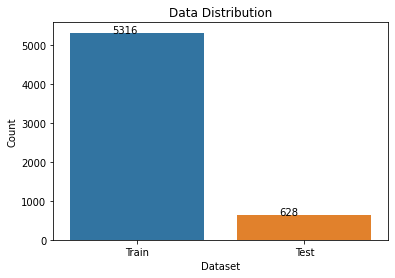

In [224]:
processed_data_dir = 'processed_data' # data directory

processed_data_df = get_file_path_df(processed_data_dir)
processed_train_df, processed_test_df = get_train_test_df(processed_data_df)

# creating a bar plot
plot = sns.barplot(['Train', 'Test'], 
                   [processed_train_df.shape[0], processed_test_df.shape[0]])
plt.title('Data Distribution')
plt.xlabel('Dataset')
plt.ylabel('Count')

# adding class count to the barplot
for patch in plot.patches:
    # formatting and positioning the count values
    plot.annotate('{:n}'.format(patch.get_height()), 
                  (patch.get_x()+0.25, patch.get_height()+1)) 
plt.show()

#### Observations:
* Data contains 5316 training images
* Data contains 628 test images

In [225]:
def get_class_distrib(df):
  """
  Function to get class distribution within a dataset
  takes dataframe input and plots the class distribtution
  """
  label_count = df['label'].value_counts()
  plot = sns.barplot(list(label_count.index), list(label_count.values))
  plt.title('Class Distribution')
  plt.xlabel('Class Label')
  plt.ylabel('Count')

  # adding class count to the barplot
  for patch in plot.patches:
      # formatting and positioning the count values
      plot.annotate('{:n}'.format(patch.get_height()), 
                    (patch.get_x()+0.25, patch.get_height()+1)) 
  plt.show()


Class distribution of training data


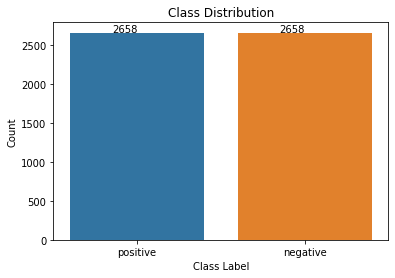

In [226]:
print("Class distribution of training data")
get_class_distrib(processed_train_df)

#### Observations:
* Now training data contains equal number of positive and negative class images

### Visualizing the data

In [227]:
import random
import imgaug as ia
folder_old = 'data/Train data/Positive data'
folder_new = 'processed_data/train/positive'

In [228]:
def get_image_BBox(path, annot_df, img_id):
  """
  Function reads an image & return corresponding BBox coordinates
  Inputs:
    1. path: image path
    2. annot_df: BBox data frame
    3. img_id: image id
  Output: 
    image and corresponding BBox coordinates
  """
  # read an image
  image = imageio.imread(path)

  # extract BBox coordinates from a data frame
  bbox_coords = annot_df[annot_df['image_id'] == img_id]
  bbox_coords = bbox_coords[['x', 'y', 'x_max', 'y_max']].values
  bbox_coords = BoundingBoxesOnImage.from_xyxy_array(bbox_coords, shape=image.shape)

  return image, bbox_coords

In [233]:
def visualize_data(img_dir_old, annot_df_old, img_dir_new, annot_df_new):
    """
    Function to visualize images before and after augmentation
    Inputs:
        1. img_dir_old: directory of images
        2. annot_df_old: BBox data frame
        3. img_dir_new: directory of augmented images
        4. annot_df_new: BBox data frame of augmented images
    Outputs:
        image & augmented image
    """

    # 5 random images
    smpls = random.sample(os.listdir(img_dir_old), 5)

    plt.figure(figsize = (6, 25))
    
    for old_img in smpls:
        # image path
        old_path = f'{img_dir_new}/{old_img}'
        # image id
        old_img_id = old_img.split('.')[0]
        f = ''
        for file in os.listdir(img_dir_new):
            split_name = file.split('_')
            
            if len(split_name) <= 1:
                continue
            else:
                if split_name[0] == old_img_id:
                    f = file
                    break
        if f:
            new_path = f'{img_dir_new}/{f}'
            new_img_id = f.split('.')[0]
        else:
            new_path = old_path
            new_img_id = old_img_id
            
        print(old_path)
        print(new_path)

        # image and corresponding BBoxes
        img_old, bbox_old = get_image_BBox(old_path, annot_df_old, old_img_id)
        img_new, bbox_new = get_image_BBox(new_path, annot_df_new, new_img_id)

        ia.imshow(np.hstack([
            bbox_old.draw_on_image(img_old, size=10, color=[0, 0, 255]),
            bbox_new.draw_on_image(img_new, size=10, color=[0, 0, 255])
            ]))

processed_data/train/positive/G0066580.JPG
processed_data/train/positive/G0066580_555.JPG


<Figure size 432x1800 with 0 Axes>

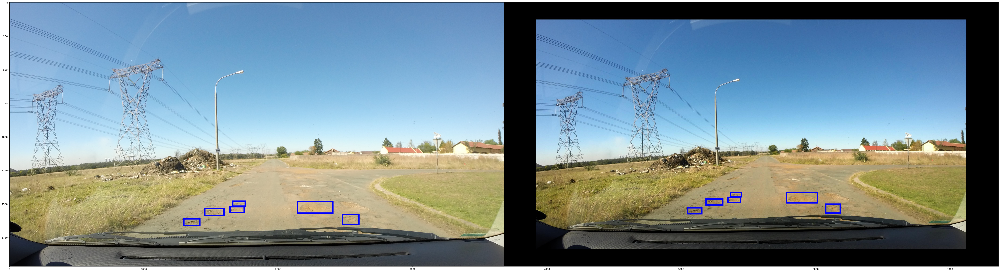

processed_data/train/positive/G0066563.JPG
processed_data/train/positive/G0066563_1069.JPG


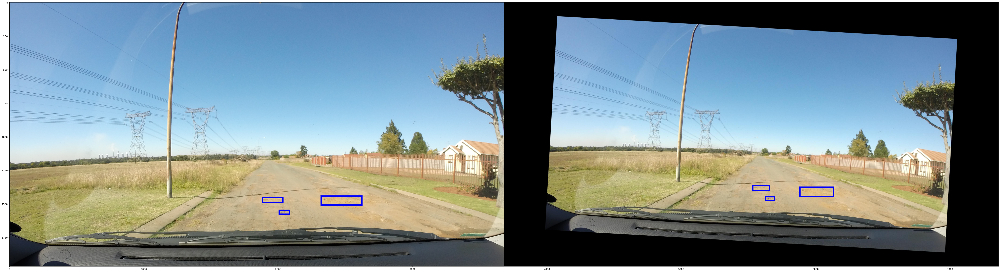

processed_data/train/positive/G0066416.JPG
processed_data/train/positive/G0066416_1130.JPG


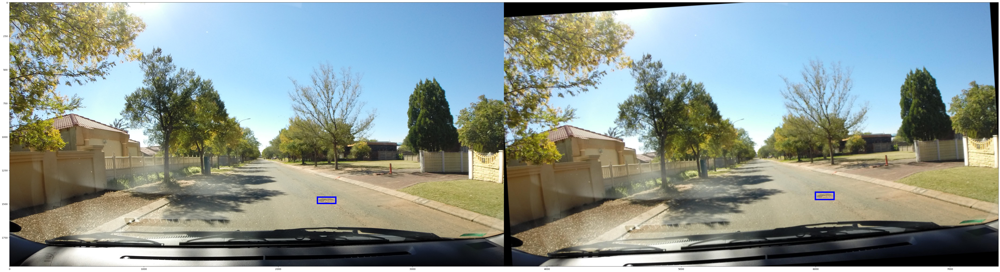

processed_data/train/positive/G0010124.JPG
processed_data/train/positive/G0010124_1529.JPG


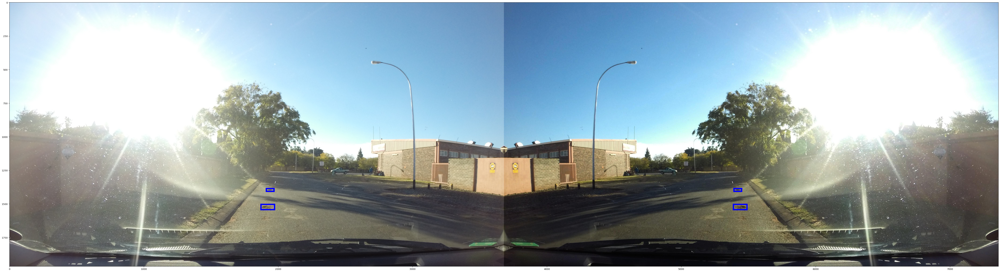

processed_data/train/positive/G0064849.JPG
processed_data/train/positive/G0064849_982.JPG


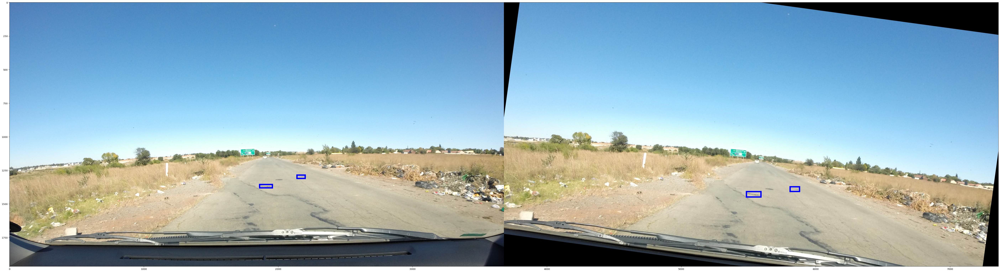

In [234]:
visualize_data(folder_old, annotation_df_new, folder_new, augmented_BBox_df)